# Executive Summary

- ***Data Properties***
- ***Steps in recreating the dataset***
- ***How was analysis performed? What type of analysis was used and why?***
- ***What were the results?***
- ***What is the recommendation?***


# Busines Problem and Objective

- ***Business Problem:*** XYZ it is planning for an investment in Cab industry and as per their Go-to-Market(G2M)  strategy they want to understand the market before taking final decision (i.e. what is the better investment opportunity for XYZ)


- ***Objective:*** Provide key insights to recommend the optimal option for XYZ’s G2M strategy


# Data Overview and Assumptions

## Import Libraries

In [105]:
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
import xlrd
from datetime import datetime
import numpy as np
from pandas_profiling import ProfileReport
import plotly.express as px
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.options.display.float_format = '{:,.2f}'.format

In [42]:
# pip install pandas_profiling for Google Colab
# ! pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip 

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     \ 22.0 MB 142 kB/s
     |████████████████████████████████| 102 kB 17.5 MB/s 
     |████████████████████████████████| 679 kB 43.5 MB/s 
     |████████████████████████████████| 62 kB 80 kB/s 
     |████████████████████████████████| 9.9 MB 44.2 MB/s 
     |████████████████████████████████| 4.7 MB 42.2 MB/s 
     |████████████████████████████████| 296 kB 43.1 MB/s 
  Created wheel for pandas-profiling: filename=pandas_profiling-dev-py2.py3-none-any.whl size=324949 sha256=65e204ca1388006c101d2526fd83ab0c3a92a8fb077294c9d178fcdc524e4b9b
  Stored in directory: /tmp/pip-ephem-wheel-cache-7lxvbzk7/wheels/64/b6/85/dfc808b23666a5910371784e349d28818006ff63ed9cfeca59
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27098 sha256=0d4f6b09ac30ea9586aba7da1500e08d923ffe5234452e514f33571ad698e4a7
  Stored in directory: /root/.cache/pip/wheels/23/14/6e/4be5bfeeb027f4939a01764b

## Load Data

In [106]:
cab = pd.read_csv('https://raw.githubusercontent.com/DataGlacier/DataSets/main/Cab_Data.csv')
city = pd.read_csv('https://raw.githubusercontent.com/DataGlacier/DataSets/main/City.csv')
customer_id = pd.read_csv('https://raw.githubusercontent.com/DataGlacier/DataSets/main/Customer_ID.csv')
transaction_id = pd.read_csv('https://raw.githubusercontent.com/DataGlacier/DataSets/main/Transaction_ID.csv')

holidays = pd.read_csv('https://raw.githubusercontent.com/agbaysa/dataglacier_week2/main/holidays.csv')
holidays['Date of Travel'] = pd.to_datetime(holidays['Date of Travel'])

weather = pd.read_csv('https://raw.githubusercontent.com/agbaysa/dataglacier_week2/main/weather_final.csv')

## Profile for each csv

In [107]:
print('Cab_Data:', cab.shape)
print('city:', city.shape)
print('customer_id:', customer_id.shape)
print('transaction_d:', transaction_id.shape)
print('holidays:', holidays.shape)
print('weather:', weather.shape)

Cab_Data: (359392, 7)
city: (20, 3)
customer_id: (49171, 4)
transaction_d: (440098, 3)
holidays: (57, 2)
weather: (864, 5)


## Overview of Field Names and Data Types

In [108]:
print('Cab_Data:', cab.dtypes)
print('')
print('city:', city.dtypes)
print('')
print('customer_id:', customer_id.dtypes)
print('')
print('transaction_d:', transaction_id.dtypes)
print('')
print('holidays:', holidays.dtypes)
print('')
print('weather:', weather.dtypes)

Cab_Data: Transaction ID      int64
Date of Travel      int64
Company            object
City               object
KM Travelled      float64
Price Charged     float64
Cost of Trip      float64
dtype: object

city: City          object
Population    object
Users         object
dtype: object

customer_id: Customer ID            int64
Gender                object
Age                    int64
Income (USD/Month)     int64
dtype: object

transaction_d: Transaction ID     int64
Customer ID        int64
Payment_Mode      object
dtype: object

holidays: Date of Travel    datetime64[ns]
Holiday                   object
dtype: object

weather: Year                 int64
Month                int64
Month_Year_State    object
State               object
Type_severity       object
dtype: object


In [109]:
# Convert integers to date
cab['Date of Travel'] = cab["Date of Travel"].map(lambda x: datetime(*xlrd.xldate_as_tuple(x, 0))).dt.date
cab['Date of Travel'] = pd.to_datetime(cab['Date of Travel'])

## Joining the Datasets to Create a Master Data

In [131]:
df = cab.merge(transaction_id, on='Transaction ID', how='left')
df = df.merge(city, on='City', how='left')
df = df.merge(customer_id, on='Customer ID', how='left' )
df.head(3)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Customer ID,Payment_Mode,Population,Users,Gender,Age,Income (USD/Month)
0,10000011,2016-01-08,Pink Cab,ATLANTA GA,30.45,370.95,313.63,29290,Card,"814,885","24,701",Male,28,10813
1,10000012,2016-01-06,Pink Cab,ATLANTA GA,28.62,358.52,334.85,27703,Card,"814,885","24,701",Male,27,9237
2,10000013,2016-01-02,Pink Cab,ATLANTA GA,9.04,125.20,97.63,28712,Cash,"814,885","24,701",Male,53,11242


In [132]:
# Merge holiday dataset
df = df.merge(holidays, on = 'Date of Travel', how='left')
df['Holiday'] = np.where(df['Holiday'] != 'Holiday', 'Not Holiday', df['Holiday'])

In [133]:
df.head(3)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Customer ID,Payment_Mode,Population,Users,Gender,Age,Income (USD/Month),Holiday
0,10000011,2016-01-08,Pink Cab,ATLANTA GA,30.45,370.95,313.63,29290,Card,"814,885","24,701",Male,28,10813,Not Holiday
1,10000012,2016-01-06,Pink Cab,ATLANTA GA,28.62,358.52,334.85,27703,Card,"814,885","24,701",Male,27,9237,Not Holiday
2,10000013,2016-01-02,Pink Cab,ATLANTA GA,9.04,125.20,97.63,28712,Cash,"814,885","24,701",Male,53,11242,Not Holiday


In [136]:
# Rename columns
df.columns = ['Transaction ID', 'Date of Travel', 'Company', 'City', 'KM Travelled',
       'Price Charged', 'Cost of Trip', 'Customer ID', 'Payment_Mode',
       'Population', 'Users', 'Gender', 'Age', 'Income_salary',
       'Holiday']

In [137]:
df.head(3)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Customer ID,Payment_Mode,Population,Users,Gender,Age,Income_salary,Holiday
0,10000011,2016-01-08,Pink Cab,ATLANTA GA,30.45,370.95,313.63,29290,Card,"814,885","24,701",Male,28,10813,Not Holiday
1,10000012,2016-01-06,Pink Cab,ATLANTA GA,28.62,358.52,334.85,27703,Card,"814,885","24,701",Male,27,9237,Not Holiday
2,10000013,2016-01-02,Pink Cab,ATLANTA GA,9.04,125.20,97.63,28712,Cash,"814,885","24,701",Male,53,11242,Not Holiday


## Feature Transformation and Additional Features 

In [138]:
# Create State column
df['State'] = df['City'].str[-2:]

In [139]:
# Additional Features
df['Income'] = round(df['Price Charged'] - df['Cost of Trip'],2)
df['Price per KM'] = round(df['Price Charged'] / df['KM Travelled'],2)
df['Cost per KM'] = round(df['Cost of Trip'] / df['KM Travelled'], 2)
df['Income per KM'] = round(df['Income'] / df['KM Travelled'], 2)
df['Profitable'] = np.where(df['Income'] < 0, 'Not Profitable','Profitable')
df['Profit_perc'] = df['Income'] / df['Price Charged']

# Get Day of Week, Month, and Year
df['Day of Week'] = df['Date of Travel'].dt.dayofweek
df['Month'] = df['Date of Travel'].dt.month
df['Year'] = df['Date of Travel'].dt.year

# Convert to numeric
df['Population'] = df['Population'].str.replace(',','').astype('int')
df['Users'] = df['Users'].str.replace(',','').astype('int')

# Age categories
df['Age_cat'] = 'x'
df['Age_cat'].loc[(df['Age'] <= 25)] = '18 to 25'
df['Age_cat'].loc[(df['Age'] > 25) & (df['Age'] <= 35)] = '26 to 35'
df['Age_cat'].loc[(df['Age'] > 35) & (df['Age'] <= 45)] = '36 to 45'
df['Age_cat'].loc[(df['Age'] > 45) & (df['Age'] <= 55)] = '46 to 55'
df['Age_cat'].loc[(df['Age'] > 55) & (df['Age'] <= 65)] = '56 to 65'
df['Age_cat'].loc[(df['Age'] > 65)] = '65 and above'

# Income_salary categories
df['Income_sal_cat'] = 'x'
df['Income_sal_cat'].loc[(df['Income_salary'] <= 5000)] = '5k and below'
df['Income_sal_cat'].loc[(df['Income_salary'] > 5000) & (df['Income_salary'] <= 15000)] = '>5k to 15k'
df['Income_sal_cat'].loc[(df['Income_salary'] > 15000) & (df['Income_salary'] <= 25000)] = '>15k to 25k'
df['Income_sal_cat'].loc[(df['Income_salary'] > 25000) & (df['Income_salary'] <= 35000)] = '>25k to 35k'

# Market Penetration
df['Market_Penetration'] = df['Users'] / df['Population']

# City size categories
df['City_size'] = 'x'
df['City_size'].loc[(df['Population'] <= 250000)] = '<=250k'
df['City_size'].loc[(df['Population'] > 250000) & (df['Population'] <= 1500000)] = '>250k to 1.5M'
df['City_size'].loc[(df['Population'] > 1500000)] = '>1.5M'

In [140]:
# Create Year_Month_State column
df['Month_Year_State'] =df['Month'].astype(str) + "-" + df['Year'].astype(str) + "-" + df['State']

In [141]:
df.head(3)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Customer ID,Payment_Mode,Population,Users,Gender,Age,Income_salary,Holiday,State,Income,Price per KM,Cost per KM,Income per KM,Profitable,Profit_perc,Day of Week,Month,Year,Age_cat,Income_sal_cat,Market_Penetration,City_size,Month_Year_State
0,10000011,2016-01-08,Pink Cab,ATLANTA GA,30.45,370.95,313.63,29290,Card,814885,24701,Male,28,10813,Not Holiday,GA,57.32,12.18,10.30,1.88,Profitable,0.15,4,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA
1,10000012,2016-01-06,Pink Cab,ATLANTA GA,28.62,358.52,334.85,27703,Card,814885,24701,Male,27,9237,Not Holiday,GA,23.67,12.53,11.70,0.83,Profitable,0.07,2,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA
2,10000013,2016-01-02,Pink Cab,ATLANTA GA,9.04,125.20,97.63,28712,Cash,814885,24701,Male,53,11242,Not Holiday,GA,27.57,13.85,10.80,3.05,Profitable,0.22,5,1,2016,46 to 55,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA


In [142]:
# Merge weather data
df = df.merge(weather, on = 'Month_Year_State', how='left')

In [143]:
df.head(3)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Customer ID,Payment_Mode,Population,Users,Gender,Age,Income_salary,Holiday,State_x,Income,Price per KM,Cost per KM,Income per KM,Profitable,Profit_perc,Day of Week,Month_x,Year_x,Age_cat,Income_sal_cat,Market_Penetration,City_size,Month_Year_State,Year_y,Month_y,State_y,Type_severity
0,10000011,2016-01-08,Pink Cab,ATLANTA GA,30.45,370.95,313.63,29290,Card,814885,24701,Male,28,10813,Not Holiday,GA,57.32,12.18,10.30,1.88,Profitable,0.15,4,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,"2,016.00",1.00,GA,Rain-Light
1,10000012,2016-01-06,Pink Cab,ATLANTA GA,28.62,358.52,334.85,27703,Card,814885,24701,Male,27,9237,Not Holiday,GA,23.67,12.53,11.70,0.83,Profitable,0.07,2,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,"2,016.00",1.00,GA,Rain-Light
2,10000013,2016-01-02,Pink Cab,ATLANTA GA,9.04,125.20,97.63,28712,Cash,814885,24701,Male,53,11242,Not Holiday,GA,27.57,13.85,10.80,3.05,Profitable,0.22,5,1,2016,46 to 55,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,"2,016.00",1.00,GA,Rain-Light


In [144]:
# Drop redundant columns
df.drop(['Year_y', 'Month_y','State_y'], axis=1, inplace=True)

In [146]:
# Rename columns
df.columns = ['Transaction ID', 'Date of Travel', 'Company', 'City', 'KM Travelled',
       'Price Charged', 'Cost of Trip', 'Customer ID', 'Payment_Mode',
       'Population', 'Users', 'Gender', 'Age', 'Income_salary', 'Holiday',
       'State', 'Income', 'Price per KM', 'Cost per KM', 'Income per KM',
       'Profitable', 'Profit_perc', 'Day of Week', 'Month', 'Year',
       'Age_cat', 'Income_sal_cat', 'Market_Penetration', 'City_size',
       'Month_Year_State', 'Type_severity']

## Removal of Duplicates

In [147]:
df.drop_duplicates(keep='first', inplace=True)
df.shape

(359392, 31)

In [148]:
print('df shape:', df.shape)
print('cab shape:', cab.shape)

df shape: (359392, 31)
cab shape: (359392, 7)


In [149]:
# Replace NaN with UNKN for Type_severity column
df['Type_severity'][df['Type_severity'].isnull()] = 'UNKN'

In [150]:
df.head(3)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Customer ID,Payment_Mode,Population,Users,Gender,Age,Income_salary,Holiday,State,Income,Price per KM,Cost per KM,Income per KM,Profitable,Profit_perc,Day of Week,Month,Year,Age_cat,Income_sal_cat,Market_Penetration,City_size,Month_Year_State,Type_severity
0,10000011,2016-01-08,Pink Cab,ATLANTA GA,30.45,370.95,313.63,29290,Card,814885,24701,Male,28,10813,Not Holiday,GA,57.32,12.18,10.30,1.88,Profitable,0.15,4,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,Rain-Light
1,10000012,2016-01-06,Pink Cab,ATLANTA GA,28.62,358.52,334.85,27703,Card,814885,24701,Male,27,9237,Not Holiday,GA,23.67,12.53,11.70,0.83,Profitable,0.07,2,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,Rain-Light
2,10000013,2016-01-02,Pink Cab,ATLANTA GA,9.04,125.20,97.63,28712,Cash,814885,24701,Male,53,11242,Not Holiday,GA,27.57,13.85,10.80,3.05,Profitable,0.22,5,1,2016,46 to 55,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,Rain-Light


In [151]:
# Recheck duplicates
foo = df[df.duplicated()]
print(foo)

Empty DataFrame
Columns: [Transaction ID, Date of Travel, Company, City, KM Travelled, Price Charged, Cost of Trip, Customer ID, Payment_Mode, Population, Users, Gender, Age, Income_salary, Holiday, State, Income, Price per KM, Cost per KM, Income per KM, Profitable, Profit_perc, Day of Week, Month, Year, Age_cat, Income_sal_cat, Market_Penetration, City_size, Month_Year_State, Type_severity]
Index: []


In [152]:
df.dtypes

Transaction ID                 int64
Date of Travel        datetime64[ns]
Company                       object
City                          object
KM Travelled                 float64
Price Charged                float64
Cost of Trip                 float64
Customer ID                    int64
Payment_Mode                  object
Population                     int64
Users                          int64
Gender                        object
Age                            int64
Income_salary                  int64
Holiday                       object
State                         object
Income                       float64
Price per KM                 float64
Cost per KM                  float64
Income per KM                float64
Profitable                    object
Profit_perc                  float64
Day of Week                    int64
Month                          int64
Year                           int64
Age_cat                       object
Income_sal_cat                object
M

## Data Imputation and Outlier Detection

- 

In [153]:
prof_report = ProfileReport(df)
prof_report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Key Insights: Which company has the maximum cab users at a particular period?

In [154]:
foo = pd.DataFrame(df.groupby(['Company','Year']).count())
foo.reset_index(inplace=True)
foo

px.bar(data_frame=foo, x="Year", y="Customer ID", color="Company", barmode="group",
       title='Max Cab User by Year', color_discrete_map={'Pink Cab': 'pink',
        'Yellow Cab': 'Yellow'}).update_layout(yaxis_title="Count")

# Key Insights: Does margin proportionality increase with the number of customers?

In [155]:
foo = df.groupby(['City']).agg(Total_Income=('Income', 'sum'), Count=('Income per KM', 'count'))
foo.corr()

,Total_Income,Count
Total_Income,1.00,0.86
Count,0.86,1.00


[Text(0.5, 1.0, 'Correlation: Income vs Users - Net NY')]

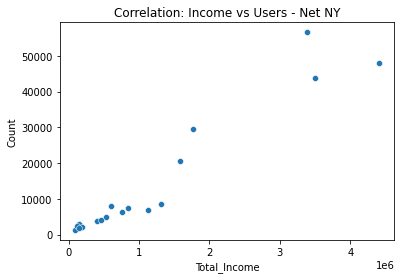

In [156]:
foo = foo.reset_index()
foo[(foo.City != 'NEW YORK NY')]
sb.scatterplot(x=foo[(foo.City != 'NEW YORK NY')]['Total_Income'], y=foo['Count']).set(title='Correlation: Income vs Users - Net NY')

# Key Insights: What are the attributes of these customer segments?

In [157]:
foo = pd.DataFrame(df.groupby(['City_size','Gender', 'Age_cat','Income_sal_cat']).count())
foo.reset_index(inplace=True)
foo

fig = px.treemap(foo, path=[px.Constant("all"), 'City_size', 'Income_sal_cat', 'Gender', 'Age_cat', ], 
                 values='Transaction ID', title='Treemap of City Size, Income Category, Gender, and Age')
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig.show()

# Key Insights: What features are correlated?

# Creation of Hypotheses

In [179]:
# 'City_size','Gender', 'Age_cat','Income_sal_cat','Type_severity'
foo = pd.DataFrame(df.groupby(['Company', 'Type_severity'])['Income'].sum())
foo.reset_index(inplace=True)
foo

fig = px.treemap(foo, path=[px.Constant("all"), 'Company', 'Type_severity'], 
                 values='Income', title='Treemap of Company Total Income: Weather Type_Severity Category')
fig.update_layout(margin = dict(t=50, l=25, r=25, b=25))
fig.show()

In [158]:
df.head(3)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Customer ID,Payment_Mode,Population,Users,Gender,Age,Income_salary,Holiday,State,Income,Price per KM,Cost per KM,Income per KM,Profitable,Profit_perc,Day of Week,Month,Year,Age_cat,Income_sal_cat,Market_Penetration,City_size,Month_Year_State,Type_severity
0,10000011,2016-01-08,Pink Cab,ATLANTA GA,30.45,370.95,313.63,29290,Card,814885,24701,Male,28,10813,Not Holiday,GA,57.32,12.18,10.30,1.88,Profitable,0.15,4,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,Rain-Light
1,10000012,2016-01-06,Pink Cab,ATLANTA GA,28.62,358.52,334.85,27703,Card,814885,24701,Male,27,9237,Not Holiday,GA,23.67,12.53,11.70,0.83,Profitable,0.07,2,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,Rain-Light
2,10000013,2016-01-02,Pink Cab,ATLANTA GA,9.04,125.20,97.63,28712,Cash,814885,24701,Male,53,11242,Not Holiday,GA,27.57,13.85,10.80,3.05,Profitable,0.22,5,1,2016,46 to 55,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,Rain-Light


In [204]:
# MA
foo = df.groupby(['Company'])['Profit_perc'].mean()
foo = pd.DataFrame(foo)
foo.reset_index(inplace=True)
foo

px.bar(data_frame=foo, x="Company", y="Profit_perc", color="Company", barmode="group",
       title='Profit Percentage', color_discrete_map={'Pink Cab': 'pink',
        'Yellow Cab': 'Yellow'}).update_layout(yaxis_title="Profit Percent")

In [220]:
foo = df.groupby(['State','Company']).agg(Profit_perc=('Profit_perc', 'mean'), Market_Penetration=('Market_Penetration', 'mean'))
foo = pd.DataFrame(foo)
foo.reset_index(inplace=True)

foo[(foo['Market_Penetration'] > 0.07) & (foo['Profit_perc'] > 0.21)]

,State,Company,Profit_perc,Market_Penetration
3,CA,Yellow Cab,0.25,0.08


In [221]:
foo = df.groupby(['Holiday','Company']).agg(Profit_perc=('Profit_perc', 'mean'), Market_Penetration=('Market_Penetration', 'mean'))
foo = pd.DataFrame(foo)
foo.reset_index(inplace=True)
foo

,Holiday,Company,Profit_perc,Market_Penetration
0,Holiday,Pink Cab,0.19,0.08
1,Holiday,Yellow Cab,0.30,0.11
2,Not Holiday,Pink Cab,0.17,0.08
3,Not Holiday,Yellow Cab,0.30,0.11


In [206]:
df.head(3)

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Customer ID,Payment_Mode,Population,Users,Gender,Age,Income_salary,Holiday,State,Income,Price per KM,Cost per KM,Income per KM,Profitable,Profit_perc,Day of Week,Month,Year,Age_cat,Income_sal_cat,Market_Penetration,City_size,Month_Year_State,Type_severity
0,10000011,2016-01-08,Pink Cab,ATLANTA GA,30.45,370.95,313.63,29290,Card,814885,24701,Male,28,10813,Not Holiday,GA,57.32,12.18,10.30,1.88,Profitable,0.15,4,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,Rain-Light
1,10000012,2016-01-06,Pink Cab,ATLANTA GA,28.62,358.52,334.85,27703,Card,814885,24701,Male,27,9237,Not Holiday,GA,23.67,12.53,11.70,0.83,Profitable,0.07,2,1,2016,26 to 35,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,Rain-Light
2,10000013,2016-01-02,Pink Cab,ATLANTA GA,9.04,125.20,97.63,28712,Cash,814885,24701,Male,53,11242,Not Holiday,GA,27.57,13.85,10.80,3.05,Profitable,0.22,5,1,2016,46 to 55,>5k to 15k,0.03,>250k to 1.5M,1-2016-GA,Rain-Light


Text(0.5, 1.0, 'Yearly Profit Percentage')

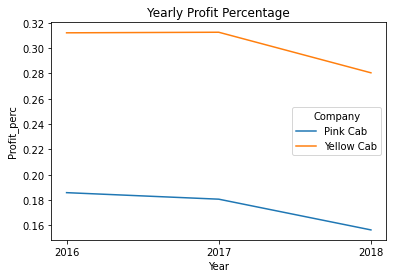

In [219]:
foo = df.groupby(['Year','Company']).agg(Profit_perc=('Profit_perc', 'mean'), Market_Penetration=('Market_Penetration', 'mean'))
foo = pd.DataFrame(foo)
foo.reset_index(inplace=True)

g = sb.lineplot(data=foo, x="Year", y="Profit_perc", hue="Company")
sb.set(rc={'figure.figsize':(11.7,8.27)})
plt.xticks([2016, 2017, 2018])
plt.title('Yearly Profit Percentage')

In [222]:
weather.shape

(864, 5)

In [223]:
df.shape

(359392, 31)